# 🧪 SAM 3 Lab — Segment Anything with Concepts
## Object Segmentation using SAM 3 & FoodSeg103 Dataset

---

## 📚 Table of Contents

| Lab | Topic | Difficulty | What You'll Learn |
|-----|-------|------------|-------------------|
| **Lab 1** | Setup & Data Exploration | ⭐ | Load model, explore dataset, visualize food images |
| **Lab 2** | Text Prompt Segmentation | ⭐⭐ | Type a word → find all matching objects |
| **Lab 3** | Point Click Segmentation | ⭐⭐ | Click on image → segment one object |
| **Lab 4** | Box & Combined Prompts | ⭐⭐⭐ | Draw boxes, combine prompts for precision |

---

## 🤔 What is SAM 3?

**SAM 3 (Segment Anything Model 3)** is Meta's AI model that can find and outline
objects in images. Think of it as a smart pair of scissors that can cut out
any object you describe.

### The Big Idea
You tell SAM 3 **what** you want (using text, clicks, or boxes) → it finds and outlines it.

```
You say: "egg"  →  SAM 3 finds ALL eggs in the image
You click: ⭐   →  SAM 3 outlines the object you clicked on
You draw: 📦    →  SAM 3 outlines objects inside the box
```

### 5 Ways to Tell SAM 3 What You Want

| # | Prompt Type | Example | Finds |
|---|-------------|---------|-------|
| 1 | **Text** 💬 | `"egg"` | ALL eggs in image |
| 2 | **Single Click** 📍 | Click on an egg | That ONE egg |
| 3 | **Multiple Clicks** 📍📍 | Click 3 spots on an egg | That egg (more precise) |
| 4 | **Bounding Box** 📦 | Draw rectangle around egg | Object inside the box |
| 5 | **Combined** 📦+📍 | Box + clicks | Most precise result |

### Architecture (Simplified)
```
┌─────────────────────────────────────────┐
│       🧠 Perception Encoder             │
│    (Understands images + text)           │
├──────────────────┬──────────────────────┤
│  🔍 Detector     │  🎯 Tracker          │
│  "Find objects"  │  "Follow objects"    │
│  (Text prompts)  │  (Click/box prompts) │
└──────────────────┴──────────────────────┘
```

### 🔗 Resources
- [Paper (arXiv)](https://arxiv.org/abs/2511.16719)
- [GitHub](https://github.com/facebookresearch/sam3)
- [HuggingFace Model](https://huggingface.co/facebook/sam3)

---
## 📦 About the Dataset: FoodSeg103

We'll use **FoodSeg103** — a collection of food images with pixel-level labels.

| Property | Value |
|---|---|
| **Images** | 7,118 food photos |
| **Categories** | 103 food types (rice, egg, bread, tomato, ...) |
| **Labels** | Every pixel is labeled with what food it belongs to |
| **Source** | [HuggingFace](https://huggingface.co/datasets/EduardoPacheco/FoodSeg103) |

**Why food images?** 🍳
- Easy to understand (everyone knows what an egg looks like!)
- Multiple objects per image (plates have several food items)
- Ground truth masks let us measure how well SAM 3 performs

---
# 🟢 Lab 1: Setup & Data Exploration

### 🎯 Learning Objectives
By the end of this lab, you will:
1. Load the SAM 3 model and processor
2. Load and explore the FoodSeg103 dataset
3. Understand image, mask, and label relationships
4. Visualize food images with their ground truth segmentation

In [1]:
# ============================================================
# Step 1.1: Install packages (run once, then comment out)
# ============================================================
#!pip install -U transformers torch torchvision datasets accelerate matplotlib numpy Pillow
!uv pip install -U transformers

Using Python 3.12.3 environment at: /opt/venv
Resolved 28 packages in 410ms                                        
Prepared 4 packages in 649ms                                             
Uninstalled 4 packages in 137ms
Installed 4 packages in 36ms                                
 - filelock==3.20.0
 + filelock==3.21.2
 - fsspec==2025.10.0
 + fsspec==2026.2.0
 - numpy==2.3.5
 + numpy==2.4.2
 - packaging==25.0
 + packaging==26.0


In [2]:
# ============================================================
# Step 1.2: Authenticate with HuggingFace
# ============================================================
# You need a HuggingFace account with access to facebook/sam3
# Get your token at: https://huggingface.co/settings/tokens

from huggingface_hub import login
login(token='token')  # <-- Replace with your token
print("✅ Logged in to HuggingFace!")

✅ Logged in to HuggingFace!


In [3]:
# ============================================================
# Step 1.3: Import libraries & check GPU
# ============================================================
import torch
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from PIL import Image as PILImage
from datasets import load_dataset
from transformers import Sam3Processor, Sam3Model
from scipy import ndimage
import random
import pandas as pd

# Check what hardware we have
print(f"PyTorch version : {torch.__version__}")
print(f"CUDA available  : {torch.cuda.is_available()}")
if torch.cuda.is_available():
    print(f"GPU name        : {torch.cuda.get_device_name(0)}")

device = "cuda" if torch.cuda.is_available() else "cpu"
print(f"\n🖥️  Using device: {device}")

PyTorch version : 2.10.0+cu130
CUDA available  : True
GPU name        : NVIDIA RTX PRO 6000 Blackwell Workstation Edition

🖥️  Using device: cuda


In [4]:
# ============================================================
# Step 1.4: Load SAM 3 model (~3.4 GB download on first run)
# ============================================================
# Two components:
#   - Processor: converts images/text into model-ready format
#   - Model: the actual neural network that does segmentation

print("⏳ Loading SAM 3 (this may take a minute on first run)...")

processor = Sam3Processor.from_pretrained("facebook/sam3")
model = Sam3Model.from_pretrained("facebook/sam3").to(device)
model.eval()  # Switch to inference mode (no training)

param_count = sum(p.numel() for p in model.parameters())
print(f"✅ SAM 3 loaded!")
print(f"   Parameters: {param_count:,} (~848M)")

⏳ Loading SAM 3 (this may take a minute on first run)...


Loading weights:   0%|          | 0/1468 [00:00<?, ?it/s]

✅ SAM 3 loaded!
   Parameters: 840,376,374 (~848M)


In [5]:
# ============================================================
# Step 1.5: Load FoodSeg103 dataset
# ============================================================
print("⏳ Loading FoodSeg103 dataset...")

ds = load_dataset("EduardoPacheco/FoodSeg103", split="train")
ds_val = load_dataset("EduardoPacheco/FoodSeg103", split="validation")

print(f"✅ Dataset loaded!")
print(f"   Training images  : {len(ds):,}")
print(f"   Validation images: {len(ds_val):,}")

⏳ Loading FoodSeg103 dataset...
✅ Dataset loaded!
   Training images  : 4,983
   Validation images: 2,135


In [6]:
# ============================================================
# Step 1.6: Understand dataset structure
# ============================================================
# Let's look at ONE sample to understand the data format

sample = ds[0]

print("📋 Each sample contains:")
print(f"   'image'           → The food photo          (type: {type(sample['image']).__name__})")
print(f"   'label'           → Pixel-wise mask         (type: {type(sample['label']).__name__})")
print(f"   'classes_on_image' → List of food class IDs  (value: {sample['classes_on_image']})")
print(f"   'id'              → Sample identifier        (value: {sample['id']})")
print(f"\n   Image size: {sample['image'].size}")
print(f"   Mask size : {sample['label'].size}")

📋 Each sample contains:
   'image'           → The food photo          (type: JpegImageFile)
   'label'           → Pixel-wise mask         (type: PngImageFile)
   'classes_on_image' → List of food class IDs  (value: [0, 48, 66, 90])
   'id'              → Sample identifier        (value: 0)

   Image size: (512, 384)
   Mask size : (512, 384)


### 💡 Key Concept: What is a Segmentation Mask?

A segmentation mask is an image where **each pixel's value** tells you which
food category that pixel belongs to.

```
Original Image:          Mask (numbers):
┌──────────────┐         ┌──────────────┐
│ 🍚🍚🍳🍳    │         │ 66 66 24 24  │  ← 66 = rice, 24 = egg
│ 🍚🍚🍳🍳    │         │ 66 66 24 24  │
│ 🥬🥬🥬🥬    │         │ 84 84 84 84  │  ← 84 = lettuce
└──────────────┘         └──────────────┘
```

In [7]:
# ============================================================
# Step 1.7: Food category labels (ID → Name mapping)
# ============================================================
# FoodSeg103 has 103 food categories, each with a numeric ID

FOODSEG103_LABELS = {
    0: "background", 1: "candy", 2: "egg tart", 3: "french fries", 4: "chocolate",
    5: "biscuit", 6: "popcorn", 7: "pudding", 8: "ice cream", 9: "cheese butter",
    10: "cake", 11: "wine", 12: "milkshake", 13: "coffee", 14: "juice",
    15: "milk", 16: "tea", 17: "almond", 18: "red beans", 19: "cashew",
    20: "dried cranberries", 21: "soy", 22: "walnut", 23: "peanut", 24: "egg",
    25: "apple", 26: "date", 27: "apricot", 28: "avocado", 29: "banana",
    30: "strawberry", 31: "cherry", 32: "blueberry", 33: "raspberry", 34: "mango",
    35: "olives", 36: "peach", 37: "lemon", 38: "pear", 39: "fig",
    40: "pineapple", 41: "grape", 42: "kiwi", 43: "melon", 44: "orange",
    45: "watermelon", 46: "steak", 47: "pork", 48: "chicken duck", 49: "sausage",
    50: "fried meat", 51: "lamb", 52: "sauce", 53: "crab", 54: "fish",
    55: "shellfish", 56: "shrimp", 57: "squid", 58: "bread", 59: "corn",
    60: "dumpling", 61: "hamburger", 62: "pizza", 63: "hanamaki baozi",
    64: "wonton", 65: "pasta", 66: "rice", 67: "noodles", 68: "soup",
    69: "cake", 70: "hotdog", 71: "spring roll", 72: "tofu", 73: "asparagus",
    74: "broccoli", 75: "Brussels sprout", 76: "cabbage", 77: "carrot",
    78: "celery", 79: "corn", 80: "cucumber", 81: "eggplant",
    82: "garlic", 83: "ginger", 84: "lettuce", 85: "mushroom",
    86: "onion", 87: "pepper", 88: "potato", 89: "pumpkin",
    90: "sweet potato", 91: "tomato", 92: "bean sprouts", 93: "green beans",
    94: "spinach", 95: "bell pepper", 96: "white radish", 97: "kidney beans",
    98: "mixed vegetables", 99: "crispy chicken", 100: "chicken wings",
    101: "french beans", 102: "other ingredients", 103: "salad"
}

# Quick lookup: name → ID
LABEL_TO_ID = {name: cid for cid, name in FOODSEG103_LABELS.items()}

print(f"✅ {len(FOODSEG103_LABELS)} food categories loaded")
print(f"   Examples: 24 → '{FOODSEG103_LABELS[24]}', 66 → '{FOODSEG103_LABELS[66]}', 91 → '{FOODSEG103_LABELS[91]}'")

✅ 104 food categories loaded
   Examples: 24 → 'egg', 66 → 'rice', 91 → 'tomato'


In [8]:
# ============================================================
# Step 1.8: Define reusable helper functions
# ============================================================
# These will be used throughout ALL labs to avoid repeating code


def get_class_names(class_ids):
    """Convert a list of class IDs to human-readable names."""
    return [FOODSEG103_LABELS.get(c, f"unknown_{c}") for c in class_ids]


def find_images_with_class(dataset, class_name, max_results=20):
    """
    Find images containing a specific food class.

    Returns a DataFrame with columns: ['index', 'class_names']
    """
    class_id = LABEL_TO_ID.get(class_name)
    if class_id is None:
        print(f"⚠️ '{class_name}' not found in labels!")
        return pd.DataFrame()

    indices = list(range(len(dataset)))
    random.shuffle(indices)

    records = []
    for idx in indices:
        if len(records) >= max_results:
            break
        sample = dataset[idx]
        if class_id in sample['classes_on_image']:
            names = get_class_names(sample['classes_on_image'])
            records.append({'index': idx, 'class_names': names})

    return pd.DataFrame(records)


def show_image_with_mask(image, label, title="", figsize=(18, 6)):
    """Show original image, mask, and overlay side by side."""
    fig, axes = plt.subplots(1, 3, figsize=figsize)
    label_array = np.array(label)

    axes[0].imshow(image)
    axes[0].set_title("Original Image", fontsize=13)
    axes[0].axis('off')

    axes[1].imshow(label_array, cmap='tab20')
    axes[1].set_title("Ground Truth Mask", fontsize=13)
    axes[1].axis('off')

    axes[2].imshow(image)
    axes[2].imshow(label_array, alpha=0.4, cmap='tab20')
    axes[2].set_title("Overlay", fontsize=13)
    axes[2].axis('off')

    if title:
        plt.suptitle(title, fontsize=15, fontweight='bold', y=1.02)
    plt.tight_layout()
    plt.show()


def extract_best_mask(outputs, image_size):
    """
    Extract the best mask from model outputs and resize to image dimensions.

    Args:
        outputs: model output with pred_masks and iou_scores
        image_size: (width, height) tuple

    Returns:
        (mask_array, score) — boolean numpy array and float score
    """
    masks = outputs.pred_masks.squeeze().cpu().numpy()
    scores = outputs.iou_scores.squeeze().cpu().numpy()
    best_idx = scores.argmax()
    best_mask = masks[best_idx]
    best_score = scores[best_idx]

    img_w, img_h = image_size
    mask_resized = np.array(
        PILImage.fromarray(best_mask.astype(np.float32)).resize((img_w, img_h))
    )
    return mask_resized > 0, float(best_score)


def show_pvs_result(image, mask_bool, score, prompt_title, draw_prompts_fn=None, figsize=(18, 6)):
    """
    Standard 3-panel visualization for PVS (point/box) results.

    Args:
        image: PIL Image
        mask_bool: boolean numpy array
        score: confidence score
        prompt_title: title string
        draw_prompts_fn: optional function(ax) that draws points/boxes on axes[0]
    """
    img_w, img_h = image.size
    img_array = np.array(image)
    fig, axes = plt.subplots(1, 3, figsize=figsize)

    # Panel 1: Input prompt visualization
    axes[0].imshow(image)
    if draw_prompts_fn:
        draw_prompts_fn(axes[0])
    axes[0].set_title("Input Prompt", fontsize=13)
    axes[0].axis('off')

    # Panel 2: Binary mask
    axes[1].imshow(mask_bool, cmap='gray')
    axes[1].set_title(f"Predicted Mask (score: {score:.3f})", fontsize=13)
    axes[1].axis('off')

    # Panel 3: Extracted pixels on white background
    canvas = np.ones((img_h, img_w, 3), dtype=np.uint8) * 255
    canvas[mask_bool] = img_array[mask_bool]
    axes[2].imshow(canvas)
    axes[2].set_title("Extracted Segment", fontsize=13)
    axes[2].axis('off')

    plt.suptitle(prompt_title, fontsize=16, fontweight='bold')
    plt.tight_layout()
    plt.show()


def compute_iou(mask_a, mask_b):
    """Compute Intersection over Union between two binary masks."""
    intersection = np.logical_and(mask_a, mask_b).sum()
    union = np.logical_or(mask_a, mask_b).sum()
    return intersection / union if union > 0 else 0.0


# Color scheme for point prompts
POINT_COLORS = {1: 'lime', 0: 'red'}
POINT_LABELS = {1: 'Positive ✅', 0: 'Negative ❌'}

print("✅ Helper functions defined!")
print("   Available: get_class_names(), find_images_with_class(), show_image_with_mask(),")
print("              extract_best_mask(), show_pvs_result(), compute_iou()")

✅ Helper functions defined!
   Available: get_class_names(), find_images_with_class(), show_image_with_mask(),
              extract_best_mask(), show_pvs_result(), compute_iou()


📷 Image #2628
   Size   : (512, 384)
   Classes: ['background', 'egg', 'raspberry', 'bread']


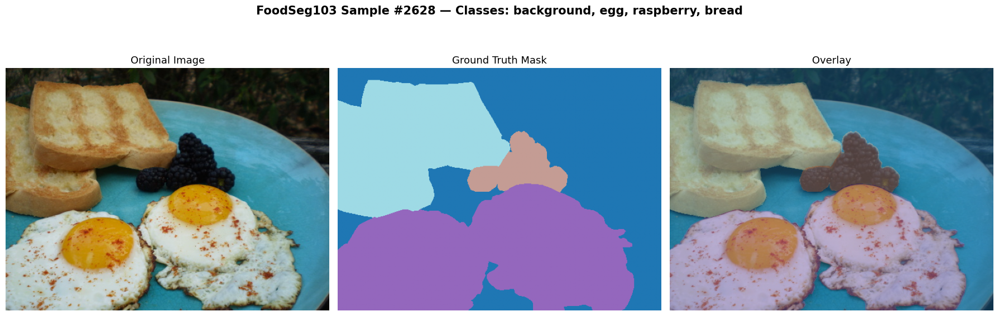

In [9]:
# ============================================================
# Step 1.9: Visualize a sample image
# ============================================================
SAMPLE_IDX = 2628  # We'll use this image throughout the lab

sample = ds[SAMPLE_IDX]
image = sample['image'].convert("RGB")
label = sample['label']
class_names = get_class_names(sample['classes_on_image'])

print(f"📷 Image #{SAMPLE_IDX}")
print(f"   Size   : {image.size}")
print(f"   Classes: {class_names}")

show_image_with_mask(
    image, label,
    title=f"FoodSeg103 Sample #{SAMPLE_IDX} — Classes: {', '.join(class_names)}"
)

In [10]:
# ============================================================
# Step 1.10: Find images containing "egg"
# ============================================================
# Let's search the dataset for images that contain eggs

df_egg = find_images_with_class(ds, "egg", max_results=20)
print(f"✅ Found {len(df_egg)} images containing 'egg'")
df_egg.head(5)

✅ Found 20 images containing 'egg'


,index,class_names
0,2251,"[background, coffee, juice, egg, fried meat, b..."
1,3529,"[background, egg, chicken duck, tofu, garlic, ..."
2,1711,"[background, egg, bread, mushroom, spinach]"
3,134,"[background, egg, sausage]"
4,2677,"[background, egg, bread]"


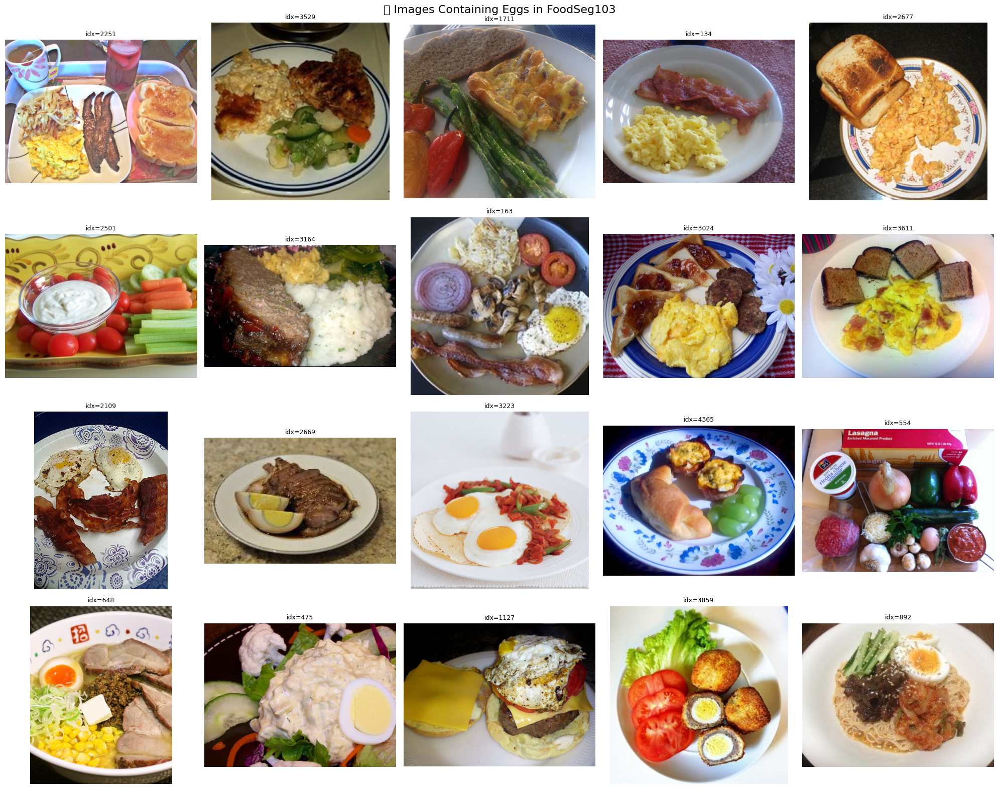


✅ Lab 1 Complete! You've loaded SAM 3 and explored the dataset.


In [11]:
# Show a grid of egg images
fig, axes = plt.subplots(4, 5, figsize=(20, 16))
for i, (_, row) in enumerate(df_egg.iterrows()):
    ax = axes[i // 5][i % 5]
    ax.imshow(ds[row['index']]['image'])
    ax.set_title(f"idx={row['index']}", fontsize=9)
    ax.axis('off')

# Hide unused axes
for j in range(len(df_egg), 20):
    axes[j // 5][j % 5].axis('off')

plt.suptitle("🥚 Images Containing Eggs in FoodSeg103", fontsize=16)
plt.tight_layout()
plt.show()

print("\n✅ Lab 1 Complete! You've loaded SAM 3 and explored the dataset.")

---
# 🟢 Lab 2: Text Prompt Segmentation

### 🎯 Learning Objectives
By the end of this lab, you will:
1. Use a **text prompt** to find all instances of a food in an image
2. Understand the 3-step pipeline: **preprocess → inference → postprocess**
3. Compare SAM 3 predictions with ground truth using **IoU**

### 💡 Key Concept: How Text Prompts Work

Unlike SAM 1/2 (which required clicking), SAM 3 lets you **type what you want**:

```
Step 1: PREPROCESS — Convert image + text into numbers the model understands
        processor(images=photo, text="egg") → tensors

Step 2: INFERENCE — Model looks at the image and finds all matching objects
        model(**inputs) → raw predictions

Step 3: POSTPROCESS — Convert raw predictions into usable masks and boxes
        processor.post_process_instance_segmentation() → masks, boxes, scores
```

**Presence Token:** Before searching, SAM 3 first asks *"Does this concept even
exist in the image?"* This avoids false detections when the object isn't there.

📷 Image #2628
   Ground truth classes: ['background', 'egg', 'raspberry', 'bread']
🔍 Text prompt: "egg"


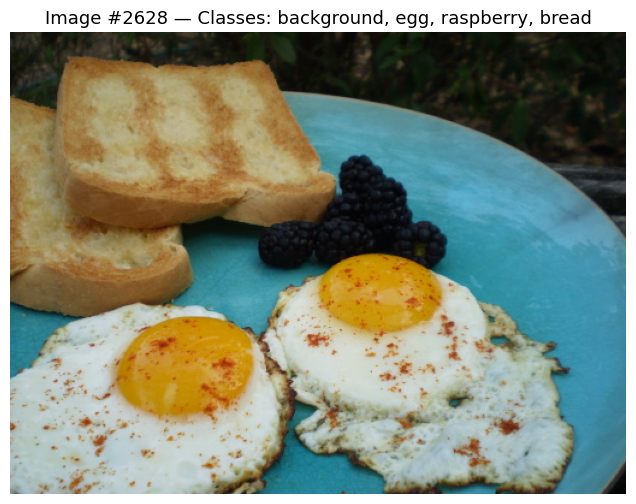

In [12]:
# ============================================================
# Step 2.1: Choose an image and a text prompt
# ============================================================
sample = ds[SAMPLE_IDX]
image = sample['image'].convert("RGB")
class_names = get_class_names(sample['classes_on_image'])

text_prompt = "egg"  # ← Try changing this to other foods!

print(f"📷 Image #{SAMPLE_IDX}")
print(f"   Ground truth classes: {class_names}")
print(f'🔍 Text prompt: "{text_prompt}"')

plt.figure(figsize=(8, 6))
plt.imshow(image)
plt.title(f"Image #{SAMPLE_IDX} — Classes: {', '.join(class_names)}", fontsize=13)
plt.axis('off')
plt.show()

In [13]:
# ============================================================
# Step 2.2: Run the 3-step pipeline
# ============================================================

# STEP 1: Preprocess — convert image + text to model inputs
inputs = processor(images=image, text=text_prompt, return_tensors="pt").to(device)
print("Step 1 ✅ Preprocessed. Input keys:", list(inputs.keys()))

# STEP 2: Inference — run the model
with torch.no_grad():  # No gradient computation (faster, less memory)
    outputs = model(**inputs)
print("Step 2 ✅ Inference complete. Output keys:", list(outputs.keys()))

# STEP 3: Postprocess — convert raw output to masks/boxes/scores
results = processor.post_process_instance_segmentation(
    outputs,
    threshold=0.3,       # Minimum confidence to keep a detection
    mask_threshold=0.5,  # Threshold for binarizing soft masks
    target_sizes=inputs.get("original_sizes").tolist()
)[0]  # [0] = first (and only) image
print("Step 3 ✅ Postprocessed.")

Step 1 ✅ Preprocessed. Input keys: ['pixel_values', 'original_sizes', 'input_ids', 'attention_mask']
Step 2 ✅ Inference complete. Output keys: ['pred_masks', 'pred_boxes', 'pred_logits', 'presence_logits', 'semantic_seg', 'decoder_reference_boxes']
Step 3 ✅ Postprocessed.


In [14]:
# ============================================================
# Step 2.3: Inspect the results
# ============================================================
num_found = len(results.get('masks', []))
print(f'🔎 Results for text prompt: "{text_prompt}"')
print(f"   Instances found: {num_found}\n")

for i, (mask, box, score) in enumerate(zip(
    results.get('masks', []),
    results.get('boxes', []),
    results.get('scores', [])
)):
    score_val = score.item() if torch.is_tensor(score) else score
    box_vals = box.cpu().tolist() if torch.is_tensor(box) else box
    mask_np = mask.cpu().numpy() if torch.is_tensor(mask) else np.array(mask)

    print(f"   Instance {i+1}:")
    print(f"     Confidence : {score_val:.4f}  {'🟢 High' if score_val > 0.7 else '🟡 Medium' if score_val > 0.4 else '🔴 Low'}")
    print(f"     Bounding box: [{', '.join(f'{v:.0f}' for v in box_vals)}]")
    print(f"     Mask pixels : {int(mask_np.sum()):,}")

🔎 Results for text prompt: "egg"
   Instances found: 2

   Instance 1:
     Confidence : 0.9507  🟢 High
     Bounding box: [209, 184, 468, 383]
     Mask pixels : 36,321
   Instance 2:
     Confidence : 0.9569  🟢 High
     Bounding box: [-0, 225, 236, 384]
     Mask pixels : 31,442


### 💡 Understanding the Output

| Field | What it means |
|-------|---------------|
| **masks** | Binary image: 1 = this pixel is part of the object, 0 = not |
| **boxes** | Rectangle `[x1, y1, x2, y2]` surrounding each detected object |
| **scores** | How confident the model is (0.0 to 1.0). Higher = more certain |

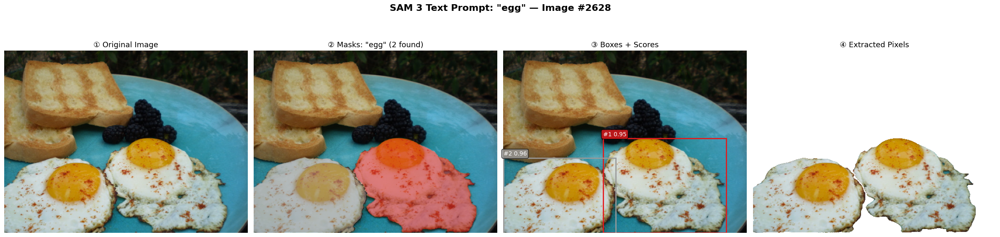

In [15]:
# ============================================================
# Step 2.4: Visualize results — 4 panels
# ============================================================
img_w, img_h = image.size
img_array = np.array(image)

fig, axes = plt.subplots(1, 4, figsize=(24, 6))
colors = plt.cm.Set1(np.linspace(0, 1, max(num_found, 1)))

# Panel 1: Original
axes[0].imshow(image)
axes[0].set_title("① Original Image", fontsize=13)
axes[0].axis('off')

# Panel 2: Mask overlay
axes[1].imshow(image)
for i, mask in enumerate(results.get('masks', [])):
    mask_np = mask.cpu().numpy() if torch.is_tensor(mask) else np.array(mask)
    colored = np.zeros((*mask_np.shape, 4))
    colored[mask_np > 0] = [*colors[i][:3], 0.5]
    axes[1].imshow(colored)
axes[1].set_title(f'② Masks: "{text_prompt}" ({num_found} found)', fontsize=13)
axes[1].axis('off')

# Panel 3: Bounding boxes + scores
axes[2].imshow(image)
for i, (box, score) in enumerate(zip(results.get('boxes', []), results.get('scores', []))):
    box_np = box.cpu().numpy() if torch.is_tensor(box) else np.array(box)
    s = score.item() if torch.is_tensor(score) else score
    x1, y1, x2, y2 = box_np
    rect = patches.Rectangle((x1, y1), x2-x1, y2-y1, lw=2, edgecolor=colors[i], facecolor='none')
    axes[2].add_patch(rect)
    axes[2].text(x1, y1-5, f"#{i+1} {s:.2f}", color='white', fontsize=10,
                 bbox=dict(boxstyle='round', facecolor=colors[i][:3], alpha=0.8))
axes[2].set_title("③ Boxes + Scores", fontsize=13)
axes[2].axis('off')

# Panel 4: Extracted pixels
combined_mask = np.zeros((img_h, img_w), dtype=bool)
for mask in results.get('masks', []):
    mask_np = mask.cpu().numpy() if torch.is_tensor(mask) else np.array(mask)
    combined_mask |= (mask_np > 0)

canvas = np.ones((img_h, img_w, 3), dtype=np.uint8) * 255
canvas[combined_mask] = img_array[combined_mask]
axes[3].imshow(canvas)
axes[3].set_title("④ Extracted Pixels", fontsize=13)
axes[3].axis('off')

plt.suptitle(f'SAM 3 Text Prompt: "{text_prompt}" — Image #{SAMPLE_IDX}',
             fontsize=16, fontweight='bold', y=1.02)
plt.tight_layout()
plt.show()

In [16]:
# ============================================================
# Step 2.5: Compare with Ground Truth (IoU evaluation)
# ============================================================
# The dataset provides "correct answers" (ground truth masks).
# We can measure accuracy using IoU (Intersection over Union).

label_array = np.array(sample['label'])
gt_class_id = LABEL_TO_ID.get(text_prompt)

if gt_class_id is not None:
    gt_mask = (label_array == gt_class_id)
else:
    gt_mask = np.zeros_like(label_array, dtype=bool)
    print(f"⚠️ '{text_prompt}' not found in labels")

# Build predicted mask (union of all detected instances)
pred_mask = combined_mask

# Compute IoU
iou = compute_iou(gt_mask, pred_mask)

print(f'📊 Evaluation for "{text_prompt}":')
print(f"   Ground truth pixels : {int(gt_mask.sum()):,}")
print(f"   Predicted pixels    : {int(pred_mask.sum()):,}")
print(f"   IoU                 : {iou:.4f}  {'🟢 Good!' if iou > 0.5 else '🟡 Moderate' if iou > 0.25 else '🔴 Low'}")

📊 Evaluation for "egg":
   Ground truth pixels : 70,215
   Predicted pixels    : 67,763
   IoU                 : 0.9650  🟢 Good!


### 💡 What is IoU (Intersection over Union)?

IoU measures how much two masks overlap. It's the standard metric for segmentation.

```
                 Overlap Area
IoU  =  ─────────────────────────────
         Total Area of Both Masks

IoU = 1.0  →  Perfect match
IoU = 0.5  →  Decent match
IoU = 0.0  →  No overlap at all
```

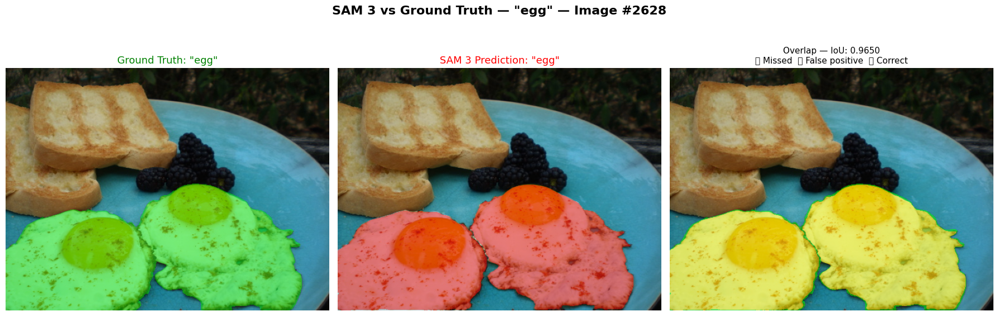

In [17]:
# ============================================================
# Step 2.6: Visualize Ground Truth vs Prediction
# ============================================================
fig, axes = plt.subplots(1, 3, figsize=(18, 6))

# Panel 1: Ground Truth (green)
axes[0].imshow(image)
gt_overlay = np.zeros((img_h, img_w, 4))
gt_overlay[gt_mask] = [0, 1, 0, 0.45]
axes[0].imshow(gt_overlay)
axes[0].set_title(f'Ground Truth: "{text_prompt}"', fontsize=13, color='green')
axes[0].axis('off')

# Panel 2: SAM 3 Prediction (red)
axes[1].imshow(image)
pred_overlay = np.zeros((img_h, img_w, 4))
pred_overlay[pred_mask] = [1, 0, 0, 0.45]
axes[1].imshow(pred_overlay)
axes[1].set_title(f'SAM 3 Prediction: "{text_prompt}"', fontsize=13, color='red')
axes[1].axis('off')

# Panel 3: Overlap comparison
axes[2].imshow(image)
overlap_overlay = np.zeros((img_h, img_w, 4))
gt_only = gt_mask & ~pred_mask
pred_only = pred_mask & ~gt_mask
both = gt_mask & pred_mask
overlap_overlay[gt_only] = [0, 1, 0, 0.5]    # Green = missed by SAM 3
overlap_overlay[pred_only] = [1, 0, 0, 0.5]   # Red = false positive
overlap_overlay[both] = [1, 1, 0, 0.5]         # Yellow = correct!
axes[2].imshow(overlap_overlay)
axes[2].set_title(f'Overlap — IoU: {iou:.4f}\n🟢 Missed  🔴 False positive  🟡 Correct',
                  fontsize=11)
axes[2].axis('off')

plt.suptitle(f'SAM 3 vs Ground Truth — "{text_prompt}" — Image #{SAMPLE_IDX}',
             fontsize=16, fontweight='bold', y=1.02)
plt.tight_layout()
plt.show()

Testing 5 random egg images...

📷 Image #475 — Classes: ['background', 'egg', 'sauce', 'tofu', 'cucumber', 'garlic', 'lettuce', 'tomato']
                    egg | GT:  1 regions | SAM3:  1 found | IoU: 0.9690
                  sauce | GT:  1 regions | SAM3:  0 found | IoU: 0.0000
                   tofu | GT:  4 regions | SAM3:  0 found | IoU: 0.0000
               cucumber | GT:  4 regions | SAM3:  2 found | IoU: 0.0003
                 garlic | GT:  1 regions | SAM3:  0 found | IoU: 0.0000
                lettuce | GT:  3 regions | SAM3:  0 found | IoU: 0.0000
                 tomato | GT:  1 regions | SAM3:  0 found | IoU: 0.0000


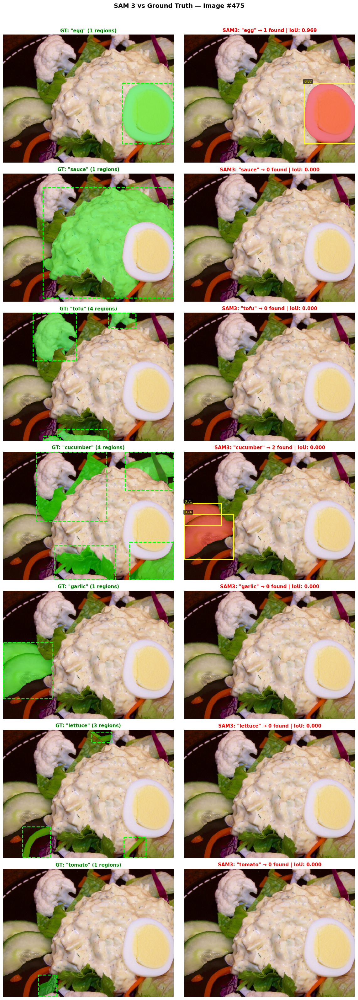

📷 Image #3024 — Classes: ['background', 'egg', 'sauce', 'bread', 'noodles']
                    egg | GT:  1 regions | SAM3:  1 found | IoU: 0.9615
                  sauce | GT:  4 regions | SAM3:  0 found | IoU: 0.0000
                  bread | GT:  1 regions | SAM3:  7 found | IoU: 0.6376
                noodles | GT:  1 regions | SAM3:  0 found | IoU: 0.0000


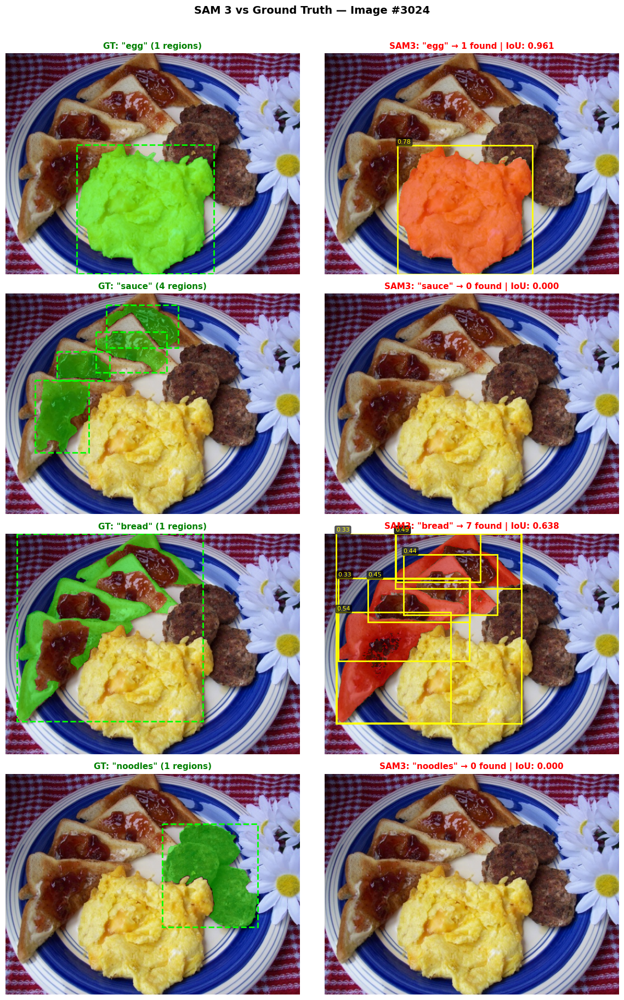

📷 Image #1127 — Classes: ['background', 'cheese butter', 'egg', 'steak', 'bread', 'asparagus']
          cheese butter | GT:  2 regions | SAM3:  5 found | IoU: 0.3706
                    egg | GT:  1 regions | SAM3:  1 found | IoU: 0.9636
                  steak | GT:  1 regions | SAM3:  0 found | IoU: 0.0000
                  bread | GT:  3 regions | SAM3:  0 found | IoU: 0.0000
              asparagus | GT:  2 regions | SAM3:  0 found | IoU: 0.0000


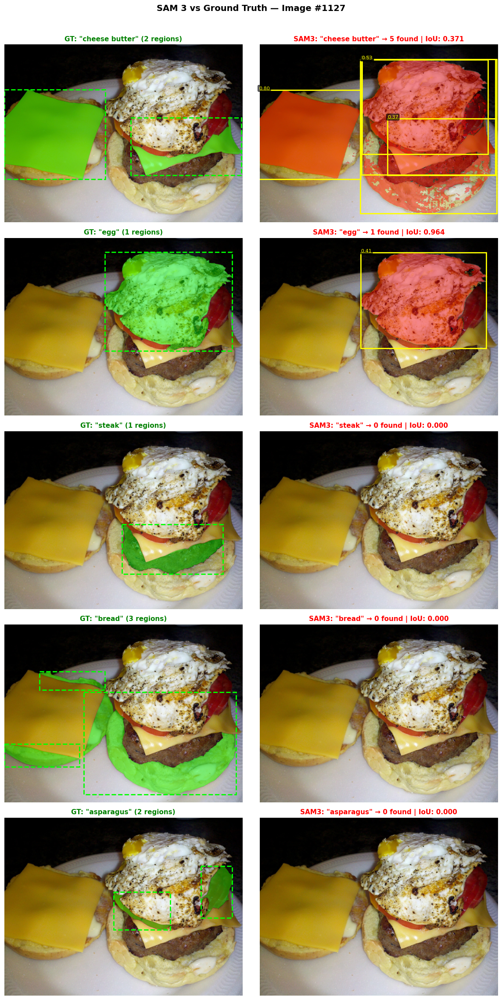

📷 Image #554 — Classes: ['background', 'egg', 'sauce', 'pasta', 'cake', 'spring roll', 'pumpkin', 'green beans', 'spinach', 'french beans']
                    egg | GT:  1 regions | SAM3:  1 found | IoU: 0.9595
                  sauce | GT:  1 regions | SAM3:  0 found | IoU: 0.0000
                  pasta | GT:  1 regions | SAM3:  0 found | IoU: 0.0000
                   cake | GT:  1 regions | SAM3:  0 found | IoU: 0.0000
            spring roll | GT:  1 regions | SAM3:  0 found | IoU: 0.0000
                pumpkin | GT:  2 regions | SAM3:  0 found | IoU: 0.0000
            green beans | GT:  1 regions | SAM3:  0 found | IoU: 0.0000
                spinach | GT:  1 regions | SAM3:  0 found | IoU: 0.0000
           french beans | GT:  1 regions | SAM3:  0 found | IoU: 0.0000


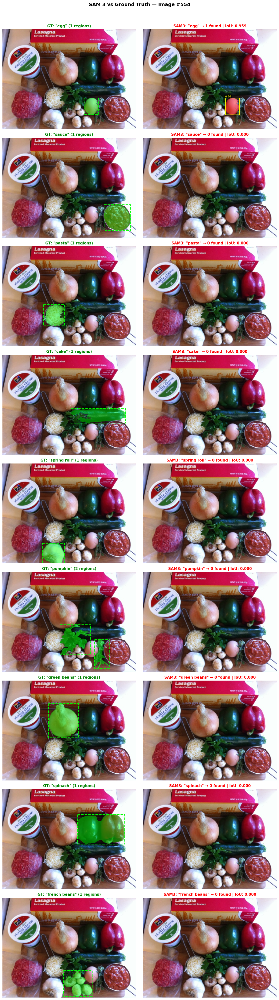

📷 Image #163 — Classes: ['background', 'egg', 'sausage', 'fried meat', 'rice', 'asparagus', 'green beans', 'mixed vegetables']
                    egg | GT:  1 regions | SAM3:  1 found | IoU: 0.9580
                sausage | GT:  1 regions | SAM3:  2 found | IoU: 0.8458
             fried meat | GT:  1 regions | SAM3:  0 found | IoU: 0.0000
                   rice | GT:  1 regions | SAM3:  0 found | IoU: 0.0000
              asparagus | GT:  1 regions | SAM3:  0 found | IoU: 0.0000
            green beans | GT:  1 regions | SAM3:  0 found | IoU: 0.0000
       mixed vegetables | GT:  1 regions | SAM3:  0 found | IoU: 0.0000


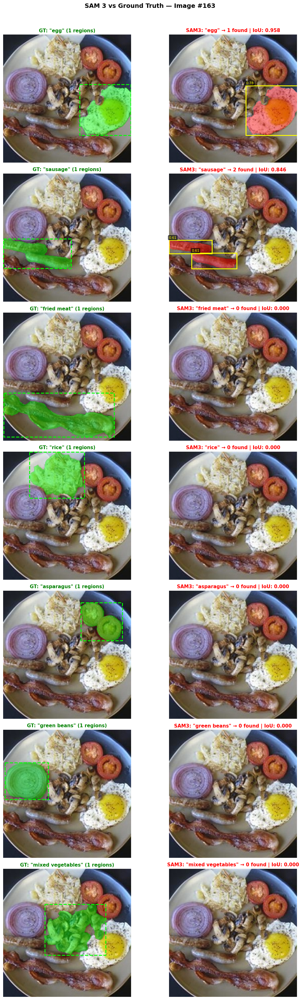


✅ Lab 2 Complete! You've used text prompts and evaluated with IoU.


In [18]:
# ============================================================
# Step 2.7: Test ALL food classes in one image
# ============================================================
# Run SAM 3 for each food class present in the image and compare with ground truth

random_rows = random.sample(range(len(df_egg)), min(5, len(df_egg)))
print(f"Testing {len(random_rows)} random egg images...\n")

for row_i in random_rows:
    sample_idx = df_egg.iloc[row_i]['index']
    sample = ds[sample_idx]
    image = sample['image'].convert("RGB")
    label_array = np.array(sample['label'])
    class_names = get_class_names(sample['classes_on_image'])
    img_w, img_h = image.size

    # Skip background, get food-only prompts
    prompts = [name for name in class_names if name != 'background']

    print(f"{'='*60}")
    print(f"📷 Image #{sample_idx} — Classes: {class_names}")

    # Pre-compute vision features once (optimization — avoids re-encoding the image)
    img_inputs = processor(images=image, return_tensors="pt").to(device)
    with torch.no_grad():
        vision_embeds = model.get_vision_features(pixel_values=img_inputs.pixel_values)

    fig, axes = plt.subplots(len(prompts), 2, figsize=(12, 4.5 * len(prompts)))
    if len(prompts) == 1:
        axes = axes.reshape(1, -1)

    for idx, prompt in enumerate(prompts):
        # --- Ground Truth ---
        gt_id = LABEL_TO_ID.get(prompt)
        gt_mask = (label_array == gt_id) if gt_id is not None else np.zeros_like(label_array, dtype=bool)

        # Find GT bounding boxes using connected components
        gt_boxes = []
        if gt_mask.sum() > 0:
            labeled_arr, num_regions = ndimage.label(gt_mask)
            for rid in range(1, num_regions + 1):
                ys, xs = np.where(labeled_arr == rid)
                gt_boxes.append([int(xs.min()), int(ys.min()), int(xs.max()), int(ys.max())])

        # --- SAM 3 Prediction ---
        text_inputs = processor(text=prompt, return_tensors="pt").to(device)
        with torch.no_grad():
            out = model(vision_embeds=vision_embeds, input_ids=text_inputs.input_ids)

        res = processor.post_process_instance_segmentation(
            out, threshold=0.3, mask_threshold=0.5,
            target_sizes=img_inputs.get("original_sizes").tolist()
        )[0]

        pred_mask = np.zeros((img_h, img_w), dtype=bool)
        for m in res.get('masks', []):
            m_np = m.cpu().numpy() if torch.is_tensor(m) else np.array(m)
            pred_mask |= (m_np > 0)

        iou = compute_iou(gt_mask, pred_mask)
        num_found = len(res.get('masks', []))

        # --- Plot: Left = GT, Right = Prediction ---
        # Ground Truth
        axes[idx, 0].imshow(image)
        gt_ov = np.zeros((img_h, img_w, 4))
        gt_ov[gt_mask] = [0, 1, 0, 0.45]
        axes[idx, 0].imshow(gt_ov)
        for gi, gb in enumerate(gt_boxes):
            x1, y1, x2, y2 = gb
            rect = patches.Rectangle((x1, y1), x2-x1, y2-y1, lw=2,
                                     edgecolor='lime', facecolor='none', linestyle='--')
            axes[idx, 0].add_patch(rect)
        axes[idx, 0].set_title(f'GT: "{prompt}" ({len(gt_boxes)} regions)',
                               fontsize=11, fontweight='bold', color='green')
        axes[idx, 0].axis('off')

        # SAM 3 Prediction
        axes[idx, 1].imshow(image)
        pred_ov = np.zeros((img_h, img_w, 4))
        pred_ov[pred_mask] = [1, 0, 0, 0.45]
        axes[idx, 1].imshow(pred_ov)
        for box, score in zip(res.get('boxes', []), res.get('scores', [])):
            b = box.cpu().numpy() if torch.is_tensor(box) else np.array(box)
            s = score.item() if torch.is_tensor(score) else score
            x1, y1, x2, y2 = b
            rect = patches.Rectangle((x1, y1), x2-x1, y2-y1, lw=2,
                                     edgecolor='yellow', facecolor='none')
            axes[idx, 1].add_patch(rect)
            axes[idx, 1].text(x1, y1-3, f'{s:.2f}', fontsize=8, color='yellow',
                             bbox=dict(boxstyle='round,pad=0.2', facecolor='black', alpha=0.6))
        axes[idx, 1].set_title(f'SAM3: "{prompt}" → {num_found} found | IoU: {iou:.3f}',
                               fontsize=11, fontweight='bold', color='red')
        axes[idx, 1].axis('off')

        print(f"   {prompt:>20s} | GT: {len(gt_boxes):>2d} regions | SAM3: {num_found:>2d} found | IoU: {iou:.4f}")

    plt.suptitle(f"SAM 3 vs Ground Truth — Image #{sample_idx}",
                 fontsize=14, fontweight='bold', y=1.01)
    plt.tight_layout()
    plt.show()

print("\n✅ Lab 2 Complete! You've used text prompts and evaluated with IoU.")

---
# 🟢 Lab 3: Point Click Segmentation (PVS)

### 🎯 Learning Objectives
By the end of this lab, you will:
1. Segment objects by **clicking** on them (positive points)
2. Use **negative points** to exclude unwanted regions
3. Compare single click vs. multiple clicks vs. positive+negative

### 💡 Key Concepts

| Point Type | Label | Meaning | When to Use |
|-----------|-------|---------|-------------|
| **Positive** ✅ | `1` | "Include this!" | Click on the object you want |
| **Negative** ❌ | `0` | "Exclude this!" | Click on nearby objects to exclude |

### Text Prompts vs Point Clicks
```
Text: "egg"  →  Finds ALL eggs (you don't control which one)
Click: ⭐     →  Segments exactly the ONE object you clicked
```

### Input Format
Points use a nested list structure:
```python
input_points = [[[[x, y]]]]        # One point
#                │  │  └── (x, y) coordinates
#                │  └── Points for this object
#                └── Objects in this image

input_labels = [[[1]]]              # 1=positive, 0=negative
```

In [19]:
# ============================================================
# Step 3.1: Load the Tracker model (for point/box prompts)
# ============================================================
# SAM 3 uses a separate "Tracker" model for click and box prompts

from transformers import Sam3TrackerProcessor, Sam3TrackerModel

tracker_processor = Sam3TrackerProcessor.from_pretrained("facebook/sam3")
tracker_model = Sam3TrackerModel.from_pretrained("facebook/sam3").to(device)
tracker_model.eval()

print("✅ Sam3Tracker loaded (for point and box prompts)")

You are using a model of type sam3_video to instantiate a model of type sam3_tracker. This is not supported for all configurations of models and can yield errors.


Loading weights:   0%|          | 0/685 [00:00<?, ?it/s]

✅ Sam3Tracker loaded (for point and box prompts)


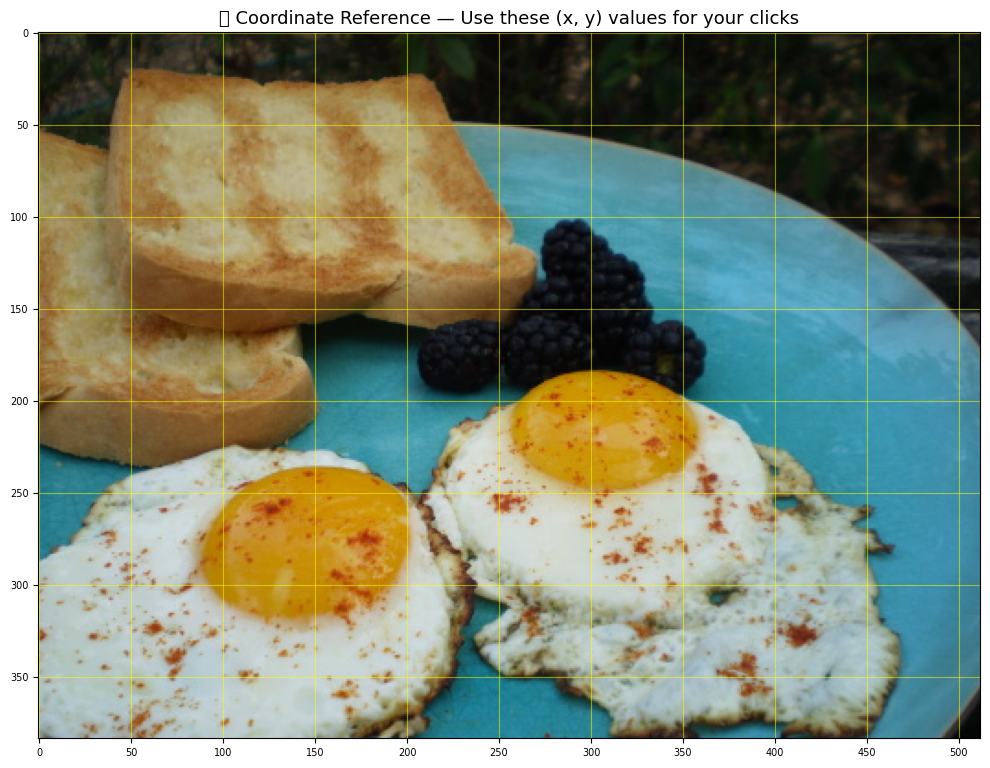

Image size: 512 × 384
💡 Tip: Find (x, y) coordinates of food items using the grid above.


In [20]:
# ============================================================
# Step 3.2: Show coordinate grid to help choose click locations
# ============================================================
sample = ds[SAMPLE_IDX]
image = sample['image'].convert("RGB")
img_w, img_h = image.size

fig, ax = plt.subplots(figsize=(10, 8))
ax.imshow(image)
ax.set_title("📍 Coordinate Reference — Use these (x, y) values for your clicks", fontsize=13)
ax.set_xticks(range(0, img_w, 50))
ax.set_yticks(range(0, img_h, 50))
ax.grid(alpha=0.5, color='yellow', linewidth=0.8)
ax.tick_params(labelsize=7)
plt.tight_layout()
plt.show()

print(f"Image size: {img_w} × {img_h}")
print("💡 Tip: Find (x, y) coordinates of food items using the grid above.")

---
## 3A: Single Point — Click Once to Segment

📍 Single click at (100, 320)


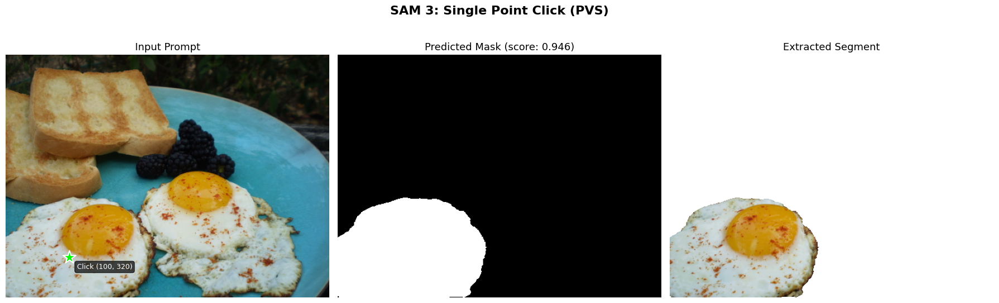

In [21]:
# ============================================================
# Step 3A: Single positive point
# ============================================================
# Click on ONE spot on a food item

input_points = [[[[100, 320]]]]  # ← Change these coordinates!
input_labels = [[[1]]]            # 1 = positive ("segment this!")

print(f"📍 Single click at ({input_points[0][0][0][0]}, {input_points[0][0][0][1]})")

# Run inference
inputs = tracker_processor(images=image, input_points=input_points,
                           input_labels=input_labels, return_tensors="pt").to(device)
with torch.no_grad():
    outputs = tracker_model(**inputs)

mask_bool, score = extract_best_mask(outputs, image.size)

# Visualize
def draw_single_point(ax):
    pt = input_points[0][0][0]
    ax.scatter(pt[0], pt[1], c='lime', s=300, marker='*',
               edgecolors='white', linewidths=1.5, zorder=5)
    ax.annotate(f'Click ({pt[0]}, {pt[1]})', (pt[0], pt[1]),
                textcoords="offset points", xytext=(10, -15),
                fontsize=9, color='white',
                bbox=dict(boxstyle='round', facecolor='black', alpha=0.7))

show_pvs_result(image, mask_bool, score,
                "SAM 3: Single Point Click (PVS)", draw_single_point)

---
## 3B: Multiple Positive Points — Click Several Times on Same Object

### 💡 Why Use Multiple Points?
A single click near an edge might only capture **part** of the object.
Multiple clicks across the object help the model understand its **full extent**.

```
Single click:           Multiple clicks:
┌──────────┐            ┌──────────┐
│          │            │  ⭐      │
│    ⭐   │  →  partial │     ⭐   │  →  complete
│          │    mask    │  ⭐      │     mask
└──────────┘            └──────────┘
```

📍 Multiple positive points:
   Point 1: (80, 300) — Positive ✅
   Point 2: (120, 340) — Positive ✅
   Point 3: (150, 310) — Positive ✅


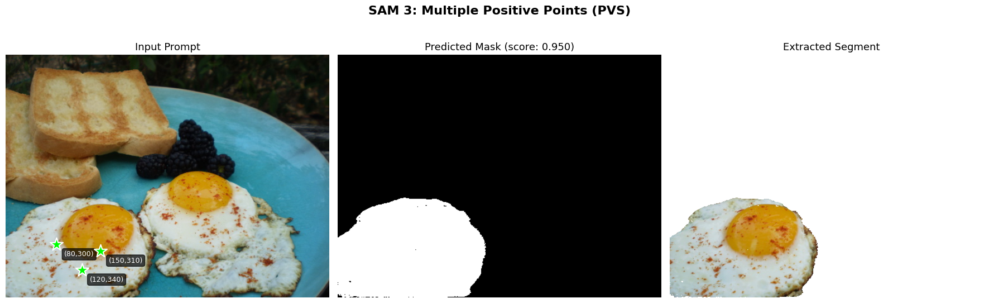

In [22]:
# ============================================================
# Step 3B: Multiple positive points on the same object
# ============================================================
input_points = [[[[80, 300], [120, 340], [150, 310]]]]  # ← 3 clicks on same food
input_labels = [[[1, 1, 1]]]                              # All positive

print("📍 Multiple positive points:")
for i, pt in enumerate(input_points[0][0]):
    print(f"   Point {i+1}: ({pt[0]}, {pt[1]}) — Positive ✅")

inputs = tracker_processor(images=image, input_points=input_points,
                           input_labels=input_labels, return_tensors="pt").to(device)
with torch.no_grad():
    outputs = tracker_model(**inputs)

mask_bool, score = extract_best_mask(outputs, image.size)

def draw_multi_points(ax):
    for pt in input_points[0][0]:
        ax.scatter(pt[0], pt[1], c='lime', s=300, marker='*',
                   edgecolors='white', linewidths=1.5, zorder=5)
        ax.annotate(f'({pt[0]},{pt[1]})', (pt[0], pt[1]),
                    textcoords="offset points", xytext=(10, -15),
                    fontsize=9, color='white',
                    bbox=dict(boxstyle='round', facecolor='black', alpha=0.7))

show_pvs_result(image, mask_bool, score,
                "SAM 3: Multiple Positive Points (PVS)", draw_multi_points)

---
## 3C: Positive + Negative Points — Include AND Exclude

### 💡 Why Use Negative Points?
When two food items are **touching**, the model might accidentally include
the neighbor. A negative point says: *"this part is NOT what I want."*

```
Without negative point:     With negative point:
┌──────────────┐            ┌──────────────┐
│ 🍚 ██████   │            │ 🍚           │
│ ⭐  ██████  │  egg+rice  │ ⭐    ████   │  egg only!
│     ██████  │  merged    │ ❌    ████   │
└──────────────┘            └──────────────┘
                             Negative on rice
```

📍 Mixed positive/negative points:
   ( 50, 320) — Positive ✅
   (130, 245) — Positive ✅
   (230, 280) — Negative ❌


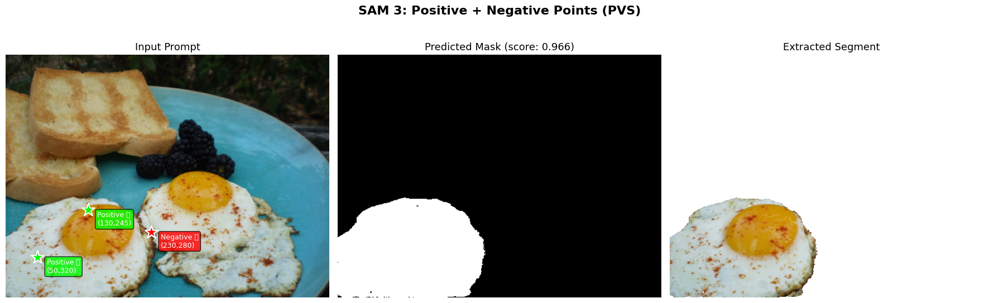

In [23]:
# ============================================================
# Step 3C: Positive + Negative points
# ============================================================
input_points = [[[[50, 320], [130, 245], [230, 280]]]]  # Target + exclusions
input_labels = [[[1, 1, 0]]]                              # Include, include, exclude

print("📍 Mixed positive/negative points:")
for pt, lbl in zip(input_points[0][0], input_labels[0][0]):
    print(f"   ({pt[0]:>3d}, {pt[1]:>3d}) — {POINT_LABELS[lbl]}")

inputs = tracker_processor(images=image, input_points=input_points,
                           input_labels=input_labels, return_tensors="pt").to(device)
with torch.no_grad():
    outputs = tracker_model(**inputs)

mask_bool, score = extract_best_mask(outputs, image.size)

def draw_mixed_points(ax):
    for pt, lbl in zip(input_points[0][0], input_labels[0][0]):
        color = POINT_COLORS[lbl]
        ax.scatter(pt[0], pt[1], c=color, s=300, marker='*',
                   edgecolors='white', linewidths=1.5, zorder=5)
        ax.annotate(f'{POINT_LABELS[lbl]}\n({pt[0]},{pt[1]})', (pt[0], pt[1]),
                    textcoords="offset points", xytext=(12, -20),
                    fontsize=9, color='white',
                    bbox=dict(boxstyle='round', facecolor=color, alpha=0.8))

show_pvs_result(image, mask_bool, score,
                "SAM 3: Positive + Negative Points (PVS)", draw_mixed_points)

---
## 3D: Side-by-Side Comparison of All Point Strategies

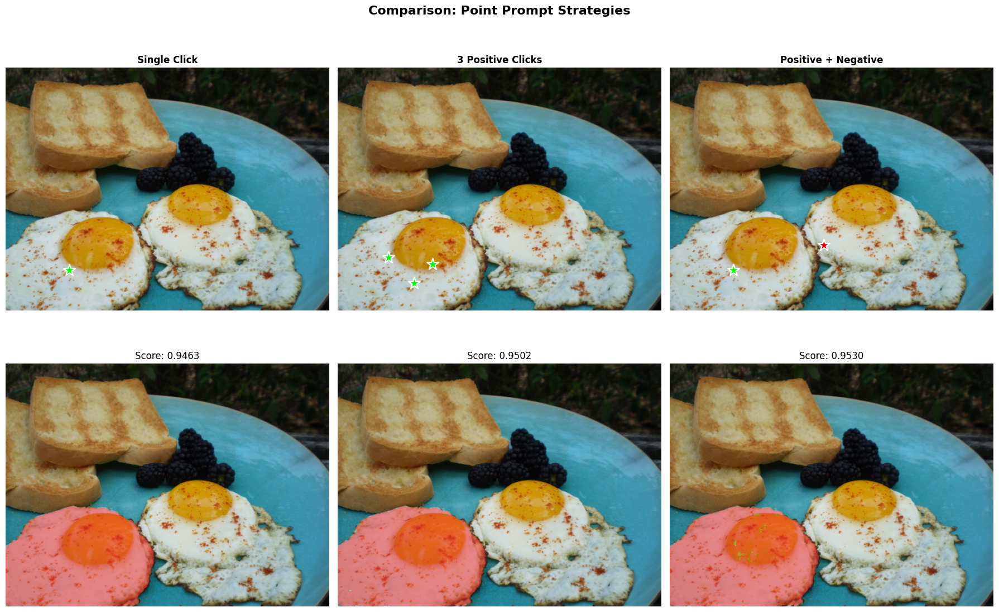


✅ Lab 3 Complete! You've learned single, multiple, and positive+negative point prompts.


In [24]:
# ============================================================
# Step 3D: Compare all three point strategies
# ============================================================

configs = [
    {'name': 'Single Click',
     'points': [[[[100, 320]]]], 'labels': [[[1]]]},
    {'name': '3 Positive Clicks',
     'points': [[[[80, 300], [120, 340], [150, 310]]]], 'labels': [[[1, 1, 1]]]},
    {'name': 'Positive + Negative',
     'points': [[[[100, 320], [243, 280]]]], 'labels': [[[1, 0]]]},
]

fig, axes = plt.subplots(2, 3, figsize=(18, 12))

for col, cfg in enumerate(configs):
    inputs = tracker_processor(images=image, input_points=cfg['points'],
                               input_labels=cfg['labels'], return_tensors="pt").to(device)
    with torch.no_grad():
        outputs = tracker_model(**inputs)

    mask_bool, score = extract_best_mask(outputs, image.size)

    # Top row: Image with points
    axes[0, col].imshow(image)
    for pt, lbl in zip(cfg['points'][0][0], cfg['labels'][0][0]):
        axes[0, col].scatter(pt[0], pt[1], c=POINT_COLORS[lbl], s=250, marker='*',
                             edgecolors='white', linewidths=1.5, zorder=5)
    axes[0, col].set_title(cfg['name'], fontsize=12, fontweight='bold')
    axes[0, col].axis('off')

    # Bottom row: Mask overlay
    axes[1, col].imshow(image)
    overlay = np.zeros((*mask_bool.shape, 4))
    overlay[mask_bool] = [1, 0.2, 0.2, 0.5]
    axes[1, col].imshow(overlay)
    axes[1, col].set_title(f"Score: {score:.4f}", fontsize=12)
    axes[1, col].axis('off')

plt.suptitle("Comparison: Point Prompt Strategies",
             fontsize=16, fontweight='bold')
plt.tight_layout()
plt.show()

print("\n✅ Lab 3 Complete! You've learned single, multiple, and positive+negative point prompts.")

---
# 🟢 Lab 4: Bounding Box & Combined Prompts

### 🎯 Learning Objectives
By the end of this lab, you will:
1. Segment objects using a **bounding box**
2. **Combine** boxes with point clicks for maximum precision
3. Compare all 6 prompt strategies side-by-side

### 💡 Key Concepts

A bounding box defines a **rectangular region**: `[x1, y1, x2, y2]`
```
(x1,y1) ─────────────┐
   │                   │
   │   food item 🍳    │
   │                   │
   └──────────────── (x2,y2)
```

### Why Combine Box + Points?
| Strategy | When to Use |
|----------|-------------|
| **Box only** | Quick selection — segment whatever's inside |
| **Box + positive point** | Multiple items in box — point picks ONE |
| **Box + pos + neg points** | Maximum control — select one, exclude others |

---
## 4A: Bounding Box Only

📦 Bounding box: [0, 225, 240, 380]


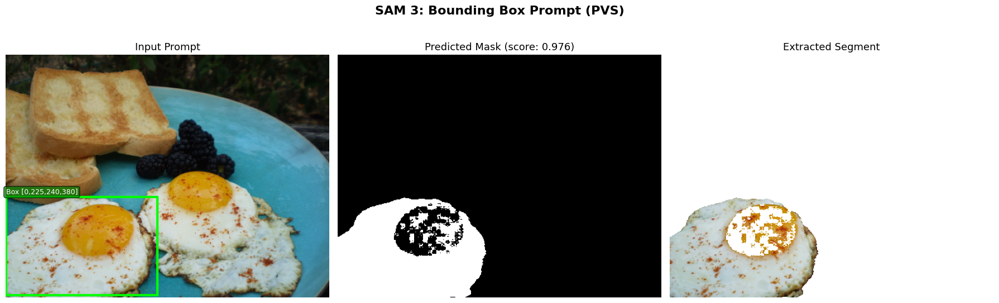

In [25]:
# ============================================================
# Step 4A: Bounding box prompt
# ============================================================
sample = ds[SAMPLE_IDX]
image = sample['image'].convert("RGB")
img_w, img_h = image.size

# Define box: [x1, y1, x2, y2] (top-left to bottom-right)
input_boxes = [[[0, 225, 240, 380]]]  # ← Adjust to surround a food item

print(f"📦 Bounding box: {input_boxes[0][0]}")

inputs = tracker_processor(images=image, input_boxes=input_boxes,
                           return_tensors="pt").to(device)
with torch.no_grad():
    outputs = tracker_model(**inputs)

mask_bool, score = extract_best_mask(outputs, image.size)

def draw_box(ax):
    x1, y1, x2, y2 = input_boxes[0][0]
    rect = patches.Rectangle((x1, y1), x2-x1, y2-y1, lw=3,
                              edgecolor='lime', facecolor='none')
    ax.add_patch(rect)
    ax.text(x1, y1-5, f'Box [{x1},{y1},{x2},{y2}]', fontsize=9, color='white',
            bbox=dict(boxstyle='round', facecolor='green', alpha=0.7))

show_pvs_result(image, mask_bool, score,
                "SAM 3: Bounding Box Prompt (PVS)", draw_box)

---
## 4B: Box + Positive Point

### 💡 When Does This Help?
When your box contains **multiple** food items, a positive point tells the
model which ONE to segment.

```
┌──────────────────┐
│  🍚 rice          │  Box covers both
│         ⭐ egg    │  Click selects the egg
└──────────────────┘
Result: Only the egg is segmented
```

📦 Box: [0, 225, 240, 380]
📍 Point: (120, 310) — Positive ✅


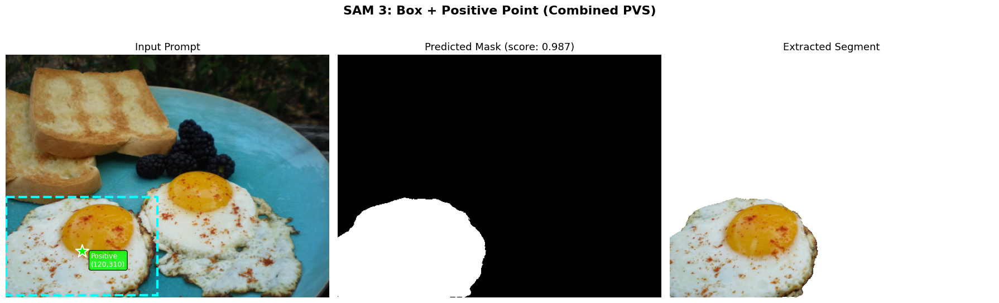

In [26]:
# ============================================================
# Step 4B: Box + positive point
# ============================================================
input_boxes = [[[0, 225, 240, 380]]]     # Same box
input_points = [[[[120, 310]]]]           # Positive click INSIDE the box
input_labels = [[[1]]]

print(f"📦 Box: {input_boxes[0][0]}")
print(f"📍 Point: ({input_points[0][0][0][0]}, {input_points[0][0][0][1]}) — Positive ✅")

inputs = tracker_processor(images=image, input_boxes=input_boxes,
                           input_points=input_points, input_labels=input_labels,
                           return_tensors="pt").to(device)
with torch.no_grad():
    outputs = tracker_model(**inputs)

mask_bool, score = extract_best_mask(outputs, image.size)

def draw_box_and_point(ax):
    x1, y1, x2, y2 = input_boxes[0][0]
    rect = patches.Rectangle((x1, y1), x2-x1, y2-y1, lw=3,
                              edgecolor='cyan', facecolor='none', linestyle='--')
    ax.add_patch(rect)
    pt = input_points[0][0][0]
    ax.scatter(pt[0], pt[1], c='lime', s=300, marker='*',
               edgecolors='white', linewidths=1.5, zorder=5)
    ax.annotate(f'Positive\n({pt[0]},{pt[1]})', (pt[0], pt[1]),
                textcoords="offset points", xytext=(12, -20),
                fontsize=9, color='white',
                bbox=dict(boxstyle='round', facecolor='lime', alpha=0.8))

show_pvs_result(image, mask_bool, score,
                "SAM 3: Box + Positive Point (Combined PVS)", draw_box_and_point)

---
## 4C: Box + Positive + Negative Points (Maximum Precision)

### 💡 The Most Powerful Combination
```
┌──────────────────────┐
│  🍚 rice  ❌          │  Negative: "not the rice"
│         ⭐ egg        │  Positive: "yes, the egg"
│     🥬 lettuce  ❌    │  Negative: "not the lettuce"
└──────────────────────┘
Result: Clean egg segmentation with precise boundaries
```

📦 Box: [0, 225, 240, 380]
📍 Points:
   (120, 310) — Positive ✅
   ( 50, 250) — Negative ❌
   (200, 350) — Negative ❌


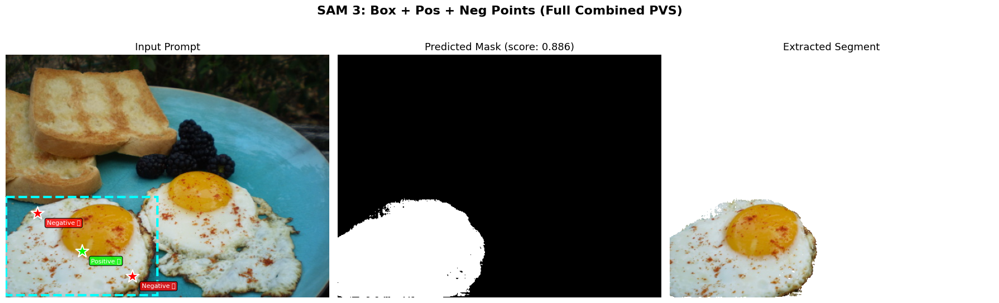

In [27]:
# ============================================================
# Step 4C: Box + positive + negative points
# ============================================================
input_boxes = [[[0, 225, 240, 380]]]
input_points = [[[[120, 310], [50, 250], [200, 350]]]]  # target + 2 exclusions
input_labels = [[[1, 0, 0]]]                              # include, exclude, exclude

print(f"📦 Box: {input_boxes[0][0]}")
print("📍 Points:")
for pt, lbl in zip(input_points[0][0], input_labels[0][0]):
    print(f"   ({pt[0]:>3d}, {pt[1]:>3d}) — {POINT_LABELS[lbl]}")

inputs = tracker_processor(images=image, input_boxes=input_boxes,
                           input_points=input_points, input_labels=input_labels,
                           return_tensors="pt").to(device)
with torch.no_grad():
    outputs = tracker_model(**inputs)

mask_bool, score = extract_best_mask(outputs, image.size)

def draw_full_combined(ax):
    x1, y1, x2, y2 = input_boxes[0][0]
    rect = patches.Rectangle((x1, y1), x2-x1, y2-y1, lw=3,
                              edgecolor='cyan', facecolor='none', linestyle='--')
    ax.add_patch(rect)
    for pt, lbl in zip(input_points[0][0], input_labels[0][0]):
        color = POINT_COLORS[lbl]
        ax.scatter(pt[0], pt[1], c=color, s=300, marker='*',
                   edgecolors='white', linewidths=1.5, zorder=5)
        ax.annotate(f'{POINT_LABELS[lbl]}', (pt[0], pt[1]),
                    textcoords="offset points", xytext=(12, -15),
                    fontsize=8, color='white',
                    bbox=dict(boxstyle='round', facecolor=color, alpha=0.8))

show_pvs_result(image, mask_bool, score,
                "SAM 3: Box + Pos + Neg Points (Full Combined PVS)", draw_full_combined)

---
## 4D: Grand Comparison — All 6 Prompt Strategies

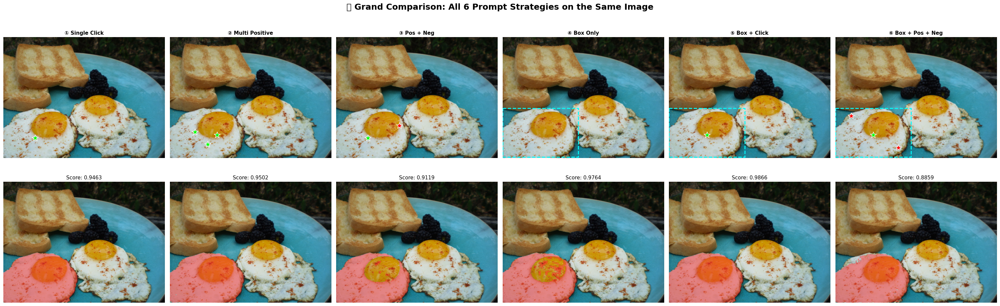


📊 Summary of All Prompt Strategies:
#    Strategy             Input                                    Best For                      
──────────────────────────────────────────────────────────────────────────────────────────────
①    Single Click         1 positive point                         Quick single-object selection 
②    Multi Positive       3+ positive points                       Capturing full extent of object
③    Pos + Neg            positive + negative points               Separating touching objects   
④    Box Only             bounding box rectangle                   Quick region selection        
⑤    Box + Click          box + 1 positive point                   Picking one item from crowded box
⑥    Box + Pos + Neg      box + pos + neg points                   Maximum precision & control   

✅ Lab 4 Complete! You've mastered all SAM 3 prompt types.


In [28]:
# ============================================================
# Step 4D: Compare ALL 6 strategies side by side
# ============================================================

all_configs = [
    {'name': '① Single Click',
     'points': [[[[100, 320]]]], 'labels': [[[1]]], 'boxes': None},
    {'name': '② Multi Positive',
     'points': [[[[80, 300], [120, 340], [150, 310]]]], 'labels': [[[1, 1, 1]]], 'boxes': None},
    {'name': '③ Pos + Neg',
     'points': [[[[100, 320], [200, 280]]]], 'labels': [[[1, 0]]], 'boxes': None},
    {'name': '④ Box Only',
     'points': None, 'labels': None, 'boxes': [[[0, 225, 240, 380]]]},
    {'name': '⑤ Box + Click',
     'points': [[[[120, 310]]]], 'labels': [[[1]]], 'boxes': [[[0, 225, 240, 380]]]},
    {'name': '⑥ Box + Pos + Neg',
     'points': [[[[120, 310], [50, 250], [200, 350]]]], 'labels': [[[1, 0, 0]]],
     'boxes': [[[0, 225, 240, 380]]]},
]

fig, axes = plt.subplots(2, 6, figsize=(30, 10))

for col, cfg in enumerate(all_configs):
    # Build inputs
    kwargs = {"images": image, "return_tensors": "pt"}
    if cfg['points'] is not None:
        kwargs["input_points"] = cfg['points']
        kwargs["input_labels"] = cfg['labels']
    if cfg['boxes'] is not None:
        kwargs["input_boxes"] = cfg['boxes']

    inputs = tracker_processor(**kwargs).to(device)
    with torch.no_grad():
        outputs = tracker_model(**inputs)

    mask_bool, score = extract_best_mask(outputs, image.size)

    # === Top: Image + prompts ===
    axes[0, col].imshow(image)
    if cfg['boxes']:
        x1, y1, x2, y2 = cfg['boxes'][0][0]
        rect = patches.Rectangle((x1, y1), x2-x1, y2-y1, lw=2,
                                  edgecolor='cyan', facecolor='none', linestyle='--')
        axes[0, col].add_patch(rect)
    if cfg['points']:
        for pt, lbl in zip(cfg['points'][0][0], cfg['labels'][0][0]):
            axes[0, col].scatter(pt[0], pt[1], c=POINT_COLORS[lbl], s=200, marker='*',
                                 edgecolors='white', linewidths=1, zorder=5)
    axes[0, col].set_title(cfg['name'], fontsize=11, fontweight='bold')
    axes[0, col].axis('off')

    # === Bottom: Mask overlay ===
    axes[1, col].imshow(image)
    overlay = np.zeros((*mask_bool.shape, 4))
    overlay[mask_bool] = [1, 0.2, 0.2, 0.5]
    axes[1, col].imshow(overlay)
    axes[1, col].set_title(f"Score: {score:.4f}", fontsize=11)
    axes[1, col].axis('off')

plt.suptitle("🏆 Grand Comparison: All 6 Prompt Strategies on the Same Image",
             fontsize=18, fontweight='bold')
plt.tight_layout()
plt.show()

# Print summary table
print("\n📊 Summary of All Prompt Strategies:")
print(f"{'#':<4} {'Strategy':<20} {'Input':<40} {'Best For':<30}")
print("─" * 94)
print(f"{'①':<4} {'Single Click':<20} {'1 positive point':<40} {'Quick single-object selection':<30}")
print(f"{'②':<4} {'Multi Positive':<20} {'3+ positive points':<40} {'Capturing full extent of object':<30}")
print(f"{'③':<4} {'Pos + Neg':<20} {'positive + negative points':<40} {'Separating touching objects':<30}")
print(f"{'④':<4} {'Box Only':<20} {'bounding box rectangle':<40} {'Quick region selection':<30}")
print(f"{'⑤':<4} {'Box + Click':<20} {'box + 1 positive point':<40} {'Picking one item from crowded box':<30}")
print(f"{'⑥':<4} {'Box + Pos + Neg':<20} {'box + pos + neg points':<40} {'Maximum precision & control':<30}")

print("\n✅ Lab 4 Complete! You've mastered all SAM 3 prompt types.")

---
# 🎓 Lab Summary

## What You Learned

| Lab | Skill | Key Takeaway |
|-----|-------|--------------|
| **1** | Setup & Exploration | SAM 3 has 848M params; FoodSeg103 has 103 food classes with pixel masks |
| **2** | Text Prompts | Type `"egg"` → SAM 3 finds ALL eggs. Measure accuracy with IoU. |
| **3** | Point Clicks | Click on object → segment it. Multiple/negative points improve results. |
| **4** | Box + Combined | Boxes define regions; combining with points gives maximum control. |

## Decision Guide: Which Prompt to Use?

```
Want to find ALL instances of something?
  └── Use TEXT PROMPT (Lab 2)

Want to segment ONE specific object?
  ├── Know roughly where it is?
  │   └── Use BOUNDING BOX (Lab 4A)
  ├── Can click on it?
  │   └── Use POINT CLICK (Lab 3A)
  └── Need precision near boundaries?
      └── Use BOX + POSITIVE + NEGATIVE (Lab 4C)
```

## 🧪 Try It Yourself!

1. Change `text_prompt = "egg"` to `"rice"`, `"bread"`, or `"tomato"` in Lab 2
2. Move the click coordinates in Lab 3 to segment different food items
3. Try images from `ds_val` (validation set) instead of `ds` (training set)
4. Lower the `threshold` in postprocessing (e.g., 0.1) — what happens?